In [1]:
!git clone https://github.com/andyypark/MachineLearning4Art.git
%cd MachineLearning4Art/

Cloning into 'MachineLearning4Art'...
remote: Enumerating objects: 8390, done.
remote: Counting objects: 100% (24/24), done.
remote: Compressing objects: 100% (20/20), done.
remote: Total 8390 (delta 4), reused 20 (delta 2), pack-reused 8366
Receiving objects: 100% (8390/8390), 699.97 MiB | 31.19 MiB/s, done.
Resolving deltas: 100% (4/4), done.
Checking out files: 100% (8359/8359), done.
/content/MachineLearning4Art


In [2]:
import PIL
import matplotlib.pyplot as plt

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torchvision.transforms as transforms
import torchvision.models as models
from tqdm import tqdm
import numpy as np


In [3]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device

device(type='cuda')

In [4]:
def preprocess_img(img_path):
    input_image = PIL.Image.open(img_path)
    input_image = input_image.convert(mode="RGB")
    
    # read_image(img_path)
    preprocess = transforms.Compose([
        transforms.Resize(256),
        transforms.CenterCrop(224),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
    ])
    input_tensor = preprocess(input_image)
    # if input_tensor.shape[0] == 1:
    #     pr
    input_batch = input_tensor.unsqueeze(0)
    return input_batch.to(device)


In [5]:
import os
from pathlib import Path
base_path = "./data/resized/"
all_images = []
for root, _, files in os.walk(Path(base_path)):
    for file in files:
        all_images.append(os.path.join(base_path, file))
len(all_images)

8355

## Clustering regular Pretrained VGG19 representations

In [6]:
vgg19_orig = models.vgg19(pretrained=True).eval()

Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to /root/.cache/torch/hub/checkpoints/vgg19-dcbb9e9d.pth


  0%|          | 0.00/548M [00:00<?, ?B/s]

In [8]:
model = nn.Sequential()
model.add_module('features', vgg19_orig.features)
model.add_module('avgpool', vgg19_orig.avgpool)
if torch.cuda.is_available():
    model = model.to('cuda')
model.eval()

Sequential(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1

In [9]:
outs = []
for i in tqdm(range(len(all_images))):
    model_input = preprocess_img(all_images[i])#.to('cuda')
    model_output = model(model_input).detach().to('cpu').numpy()#.to('cpu')
    # model_output = model_output.detach().numpy()
    outs.append(np.ndarray.flatten(model_output))

100%|██████████| 8355/8355 [02:26<00:00, 57.00it/s]


In [10]:
matrix = np.stack(outs)

In [11]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [12]:
np.save("/content/drive/MyDrive/ml4art/feats_matrix.npy", matrix)

In [ ]:
matrix = np.load("/content/drive/MyDrive/ml4art/feats_matrix.npy")

In [13]:
from torch import pca_lowrank

In [14]:
tmatrix = torch.tensor(matrix)

In [17]:
tmatrix.shape

torch.Size([8355, 25088])

In [18]:
u.shape, s.shape, v.shape

(torch.Size([8355, 100]), torch.Size([100]), torch.Size([25088, 100]))

In [15]:
u, s, v = pca_lowrank(tmatrix, q=100)

In [16]:
from sklearn.cluster import KMeans
from sklearn.neighbors import NearestNeighbors

In [19]:
kmeans = KMeans(n_clusters=50)
clusters = kmeans.fit_predict(u)

In [20]:
clusters

array([48, 12, 34, ..., 15, 41, 38], dtype=int32)

In [21]:
import pandas as pd
df = pd.DataFrame({'path':all_images, 'cluster':clusters})

In [22]:
df['artist'] = df['path'].str.split("/").apply(lambda x: x[-1]).str.split(r"\d").apply(lambda x: x[0]).str.strip("_")

In [23]:
df.sample()

,path,cluster,artist
5092,./data/resized/Vincent_van_Gogh_108.jpg,28,Vincent_van_Gogh


In [24]:
from IPython.display import Image, display

In [40]:
# from skimage.util import montage
# plt.imshow(montage(np.array(images), multichannel=True))

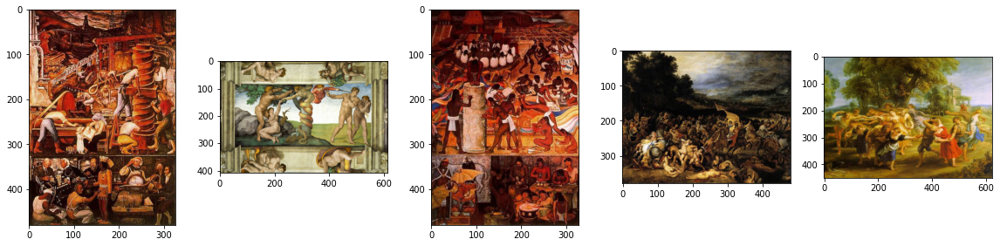

In [43]:
plt.figure(figsize=(20,10))
columns = 5
for i, image in enumerate(sample_images):
    plt.subplot(len(sample_images) / columns + 1, columns, i + 1)
    plt.imshow(image)

In [86]:
from scipy.stats import entropy

In [85]:
counts = df['artist'].value_counts()

In [87]:
entropy(counts/counts.sum())

3.5959315336572906

Cluster 0:
Edouard_Manet    1
Frida_Kahlo      1
Name: artist, dtype: int64
Cluster 0 entropy: 0.6931471805599453
Cluster 0 probability: 0.00023937761819269897


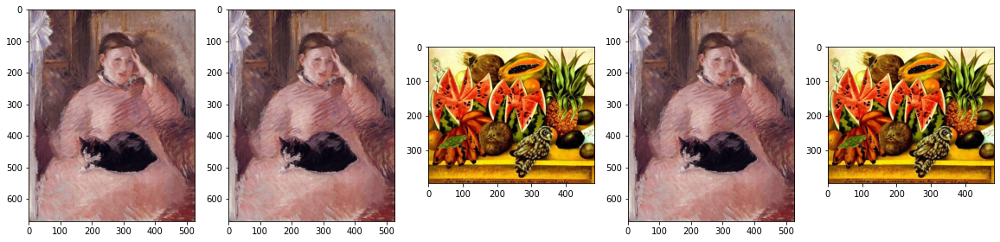

---------------------

Cluster 1:
Pablo_Picasso         53
Henri_Matisse         37
Vasiliy_Kandinskiy    17
Hieronymus_Bosch      15
Andy_Warhol           13
Marc_Chagall           9
Diego_Rivera           9
Joan_Miro              8
Vincent_van_Gogh       6
Mikhail_Vrubel         4
Paul_Klee              4
Pieter_Bruegel         3
Salvador_Dali          3
Jan_van_Eyck           2
Frida_Kahlo            2
Edgar_Degas            1
Francisco_Goya         1
Giotto_di_Bondone      1
Kazimir_Malevich       1
Rene_Magritte          1
Paul_Cezanne           1
Edvard_Munch           1
Jackson_Pollock        1
Georges_Seurat         1
Amedeo_Modigliani      1
Name: artist, dtype: int64
Cluster 1 entropy: 2.4342820991655207
Cluster 1 probability: 0.02333931777378815


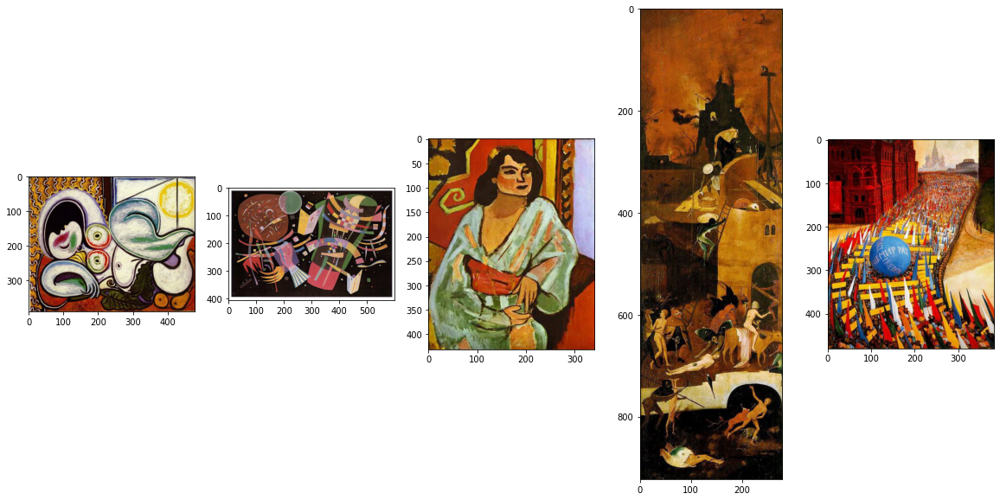

---------------------

Cluster 2:
Piet_Mondrian       24
Paul_Klee            3
Rene_Magritte        2
Kazimir_Malevich     1
Andy_Warhol          1
Name: artist, dtype: int64
Cluster 2 entropy: 0.8225219414053104
Cluster 2 probability: 0.0037103530819868344


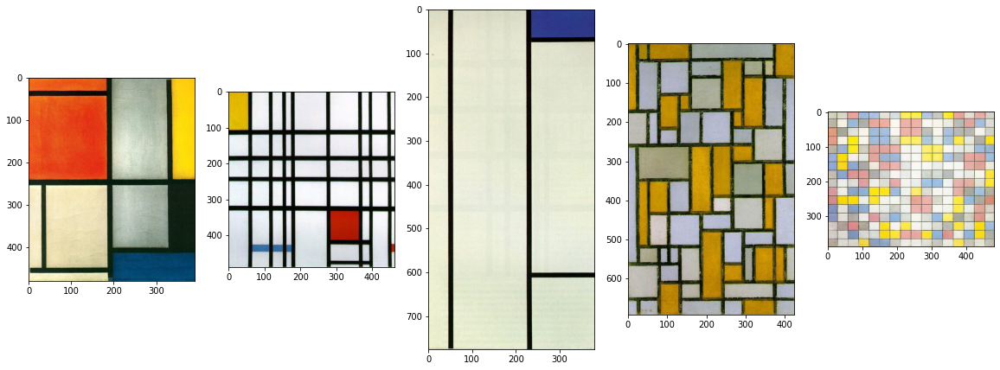

---------------------

Cluster 3:
Alfred_Sisley            110
William_Turner            34
Vincent_van_Gogh          24
Camille_Pissarro          17
Claude_Monet              13
Pierre-Auguste_Renoir      7
Pieter_Bruegel             7
Henri_Rousseau             7
Salvador_Dali              6
Paul_Gauguin               6
Edgar_Degas                5
Gustave_Courbet            5
Francisco_Goya             3
Gustav_Klimt               2
Georges_Seurat             2
Piet_Mondrian              2
Rene_Magritte              2
Diego_Velazquez            1
Kazimir_Malevich           1
Vasiliy_Kandinskiy         1
Henri_Matisse              1
Mikhail_Vrubel             1
Pablo_Picasso              1
Peter_Paul_Rubens          1
Eugene_Delacroix           1
Rembrandt                  1
Name: artist, dtype: int64
Cluster 3 entropy: 2.185087538762752
Cluster 3 probability: 0.03123877917414722


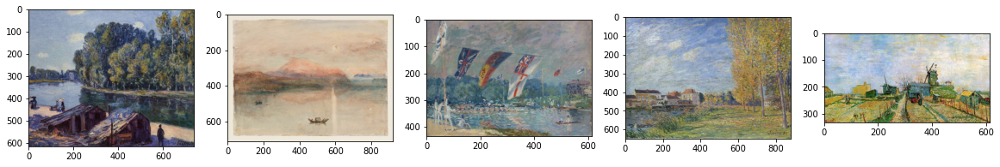

---------------------

Cluster 4:
Edgar_Degas                  132
Pierre-Auguste_Renoir         10
Pablo_Picasso                  8
Frida_Kahlo                    7
Hieronymus_Bosch               3
Edvard_Munch                   3
Amedeo_Modigliani              2
Edouard_Manet                  2
Marc_Chagall                   2
Titian                         1
Vincent_van_Gogh               1
Andrei_Rublev                  1
Paul_Klee                      1
Raphael                        1
Mikhail_Vrubel                 1
Henri_de_Toulouse-Lautrec      1
Name: artist, dtype: int64
Cluster 4 entropy: 1.1445569217226084
Cluster 4 probability: 0.02106523040095751


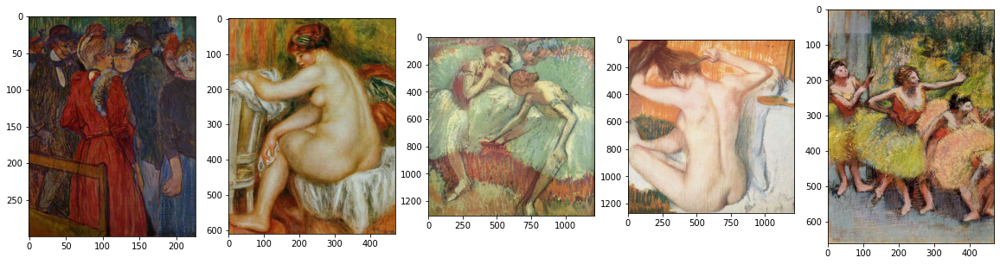

---------------------

Cluster 5:
Rembrandt                38
Francisco_Goya           25
Edgar_Degas              24
Titian                   18
Sandro_Botticelli        12
Giotto_di_Bondone        10
Hieronymus_Bosch          9
Raphael                   8
Caravaggio                7
Gustave_Courbet           6
Peter_Paul_Rubens         6
Jan_van_Eyck              6
Diego_Velazquez           5
Vincent_van_Gogh          4
Henri_Rousseau            4
Eugene_Delacroix          4
Albrecht_Dürer            3
Salvador_Dali             3
Edouard_Manet             3
Leonardo_da_Vinci         3
Rene_Magritte             3
Diego_Rivera              2
Paul_Gauguin              2
Marc_Chagall              1
Mikhail_Vrubel            1
Andrei_Rublev             1
Pierre-Auguste_Renoir     1
Camille_Pissarro          1
Henri_Matisse             1
Edvard_Munch              1
Name: artist, dtype: int64
Cluster 5 entropy: 2.8751571522379873
Cluster 5 probability: 0.02537402752842609


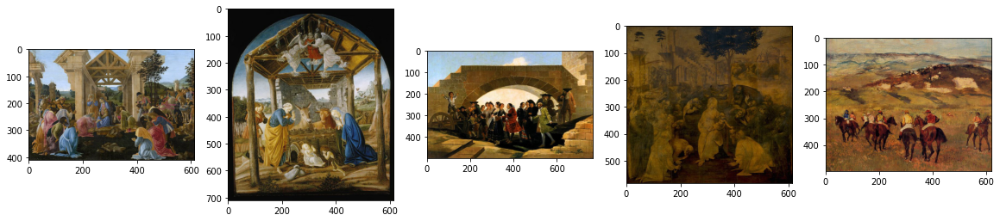

---------------------

Cluster 6:
Albrecht_Dürer               31
Rembrandt                    30
Titian                       24
Vincent_van_Gogh             12
Pierre-Auguste_Renoir         9
Edouard_Manet                 8
Pablo_Picasso                 8
Paul_Gauguin                  8
Edgar_Degas                   8
Jan_van_Eyck                  6
Sandro_Botticelli             6
Francisco_Goya                4
Gustav_Klimt                  4
Kazimir_Malevich              3
Raphael                       3
Peter_Paul_Rubens             3
Henri_de_Toulouse-Lautrec     3
Amedeo_Modigliani             2
Caravaggio                    2
Andrei_Rublev                 2
Diego_Velazquez               2
Gustave_Courbet               2
Mikhail_Vrubel                2
Leonardo_da_Vinci             2
El_Greco                      1
Piet_Mondrian                 1
Diego_Rivera                  1
Paul_Cezanne                  1
Name: artist, dtype: int64
Cluster 6 entropy: 2.8089008800850355
Clust

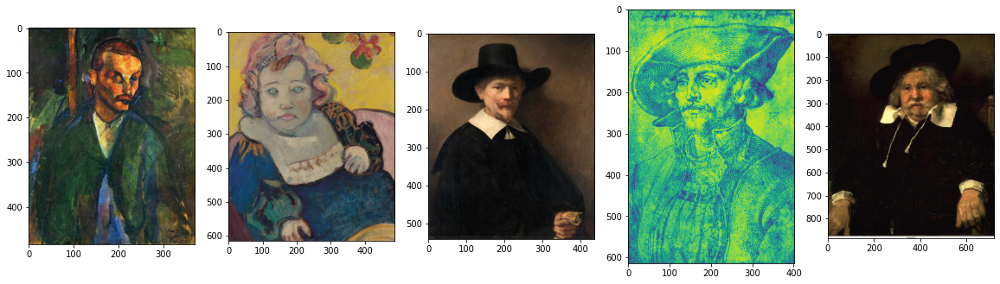

---------------------

Cluster 7:
Pablo_Picasso                41
Amedeo_Modigliani            35
Vincent_van_Gogh             11
Henri_Matisse                 7
Andy_Warhol                   6
Kazimir_Malevich              5
Joan_Miro                     4
Paul_Klee                     3
Marc_Chagall                  3
Rene_Magritte                 3
Paul_Gauguin                  3
Giotto_di_Bondone             3
Andrei_Rublev                 2
Henri_Rousseau                2
Frida_Kahlo                   2
Gustav_Klimt                  2
Edouard_Manet                 1
Francisco_Goya                1
Albrecht_Dürer                1
Henri_de_Toulouse-Lautrec     1
Salvador_Dali                 1
Sandro_Botticelli             1
Jan_van_Eyck                  1
El_Greco                      1
Name: artist, dtype: int64
Cluster 7 entropy: 2.348362840268626
Cluster 7 probability: 0.016756433273488927


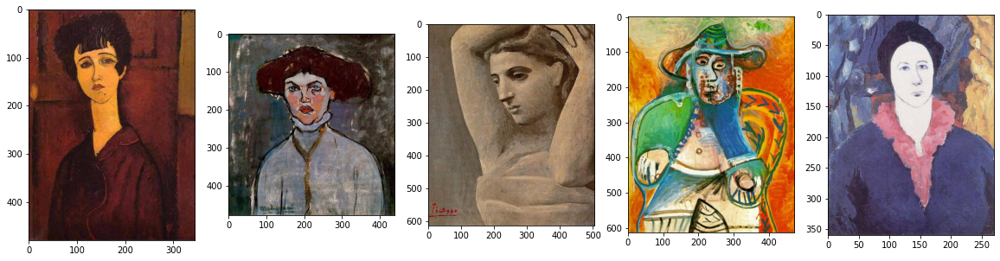

---------------------

Cluster 8:
Pablo_Picasso                16
Sandro_Botticelli            15
Vincent_van_Gogh             13
Edgar_Degas                  13
Titian                       13
Peter_Paul_Rubens            11
Amedeo_Modigliani            10
Albrecht_Dürer                8
Pierre-Auguste_Renoir         7
Hieronymus_Bosch              6
El_Greco                      6
Salvador_Dali                 6
Mikhail_Vrubel                5
Giotto_di_Bondone             5
Rembrandt                     5
Francisco_Goya                5
Paul_Gauguin                  5
Diego_Rivera                  4
Caravaggio                    4
Henri_de_Toulouse-Lautrec     4
Rene_Magritte                 3
Leonardo_da_Vinci             3
Edvard_Munch                  3
Raphael                       3
Andrei_Rublev                 2
Diego_Velazquez               2
Eugene_Delacroix              2
Michelangelo                  2
Edouard_Manet                 2
Jan_van_Eyck                  2
Pieter

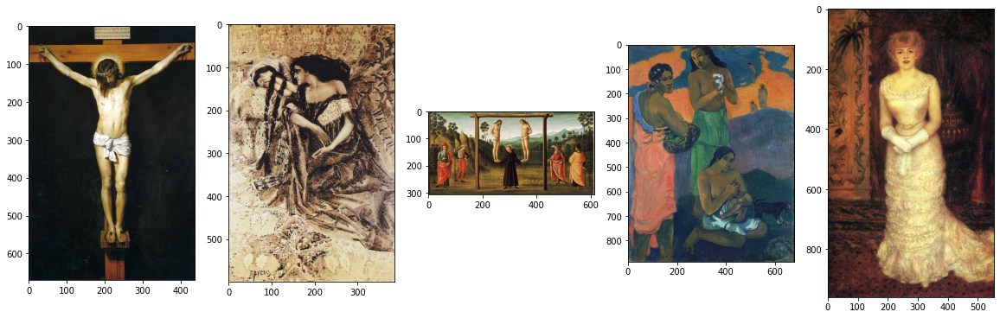

---------------------

Cluster 9:
Salvador_Dali                11
Frida_Kahlo                  11
Paul_Klee                    11
Joan_Miro                    11
Vincent_van_Gogh             10
Kazimir_Malevich              9
Pablo_Picasso                 9
Leonardo_da_Vinci             8
Hieronymus_Bosch              7
Rene_Magritte                 6
Amedeo_Modigliani             5
Pieter_Bruegel                5
Vasiliy_Kandinskiy            4
Henri_de_Toulouse-Lautrec     3
Albrecht_Dürer                3
Marc_Chagall                  3
Andy_Warhol                   3
Francisco_Goya                3
Titian                        2
Michelangelo                  2
Jan_van_Eyck                  2
Claude_Monet                  2
Rembrandt                     2
Edouard_Manet                 1
William_Turner                1
Alfred_Sisley                 1
Georges_Seurat                1
Camille_Pissarro              1
Edgar_Degas                   1
Piet_Mondrian                 1
Raphae

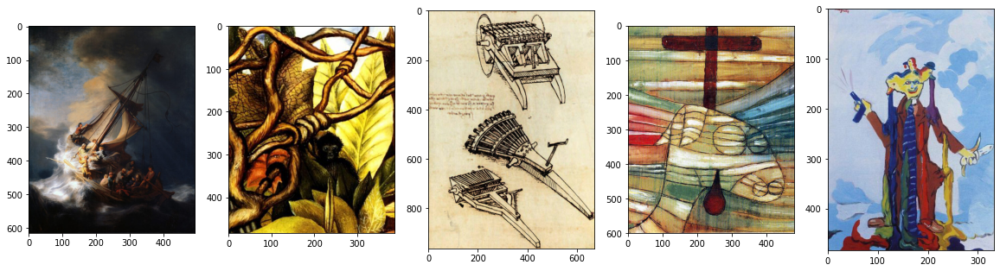

---------------------

Cluster 10:
Vincent_van_Gogh             52
Pierre-Auguste_Renoir        15
Henri_Rousseau                9
Henri_Matisse                 8
Paul_Gauguin                  6
Edgar_Degas                   5
Edouard_Manet                 5
Frida_Kahlo                   4
Mikhail_Vrubel                4
Gustave_Courbet               3
Diego_Rivera                  3
Camille_Pissarro              3
Andy_Warhol                   2
Sandro_Botticelli             2
Piet_Mondrian                 2
Paul_Cezanne                  2
Henri_de_Toulouse-Lautrec     1
Pablo_Picasso                 1
Andrei_Rublev                 1
Albrecht_Dürer                1
Paul_Klee                     1
Claude_Monet                  1
Rene_Magritte                 1
Vasiliy_Kandinskiy            1
Name: artist, dtype: int64
Cluster 10 entropy: 2.3650562050383472
Cluster 10 probability: 0.015918611609814483


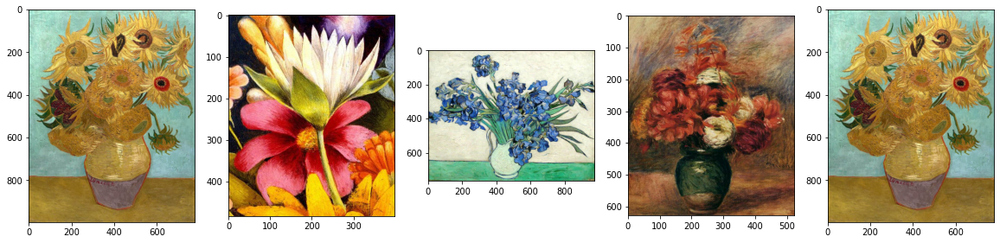

---------------------

Cluster 11:
Francisco_Goya               34
Rembrandt                    23
Edgar_Degas                  15
Vincent_van_Gogh             14
Titian                        7
Rene_Magritte                 6
Edvard_Munch                  5
Henri_Rousseau                5
Pierre-Auguste_Renoir         5
Hieronymus_Bosch              5
Mikhail_Vrubel                5
Caravaggio                    4
Diego_Velazquez               4
Paul_Gauguin                  4
Jan_van_Eyck                  4
Pablo_Picasso                 4
Marc_Chagall                  4
Henri_de_Toulouse-Lautrec     4
Andrei_Rublev                 3
Gustave_Courbet               3
Peter_Paul_Rubens             3
Raphael                       3
Leonardo_da_Vinci             2
Edouard_Manet                 2
El_Greco                      2
Gustav_Klimt                  2
Claude_Monet                  1
Camille_Pissarro              1
Paul_Cezanne                  1
Henri_Matisse                 1
Kazim

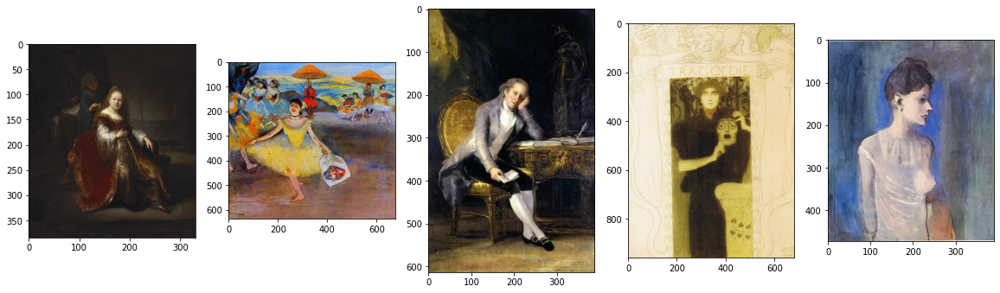

---------------------

Cluster 12:
Andy_Warhol                  55
Paul_Klee                    52
Kazimir_Malevich             51
Rene_Magritte                50
Pablo_Picasso                23
Henri_Matisse                19
Joan_Miro                    16
Salvador_Dali                11
Gustav_Klimt                  8
Hieronymus_Bosch              8
Andrei_Rublev                 7
Vincent_van_Gogh              7
Piet_Mondrian                 7
Paul_Gauguin                  5
Marc_Chagall                  4
Vasiliy_Kandinskiy            3
Albrecht_Dürer                3
Edvard_Munch                  2
Edgar_Degas                   2
Georges_Seurat                2
Henri_de_Toulouse-Lautrec     2
Rembrandt                     1
Frida_Kahlo                   1
Sandro_Botticelli             1
Paul_Cezanne                  1
Leonardo_da_Vinci             1
Giotto_di_Bondone             1
Diego_Rivera                  1
Mikhail_Vrubel                1
Jan_van_Eyck                  1
Henri

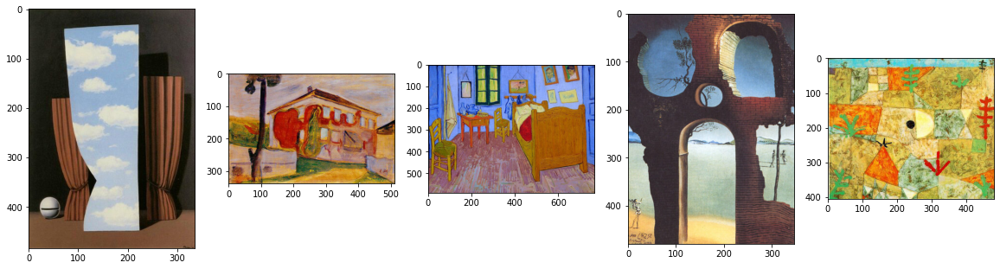

---------------------

Cluster 13:
Edgar_Degas                  37
Francisco_Goya                5
Vincent_van_Gogh              5
Salvador_Dali                 3
Paul_Gauguin                  2
Henri_Rousseau                1
Gustave_Courbet               1
Eugene_Delacroix              1
Henri_de_Toulouse-Lautrec     1
Diego_Velazquez               1
Albrecht_Dürer                1
Rene_Magritte                 1
Name: artist, dtype: int64
Cluster 13 entropy: 1.4609192554429815
Cluster 13 probability: 0.00706163973668462


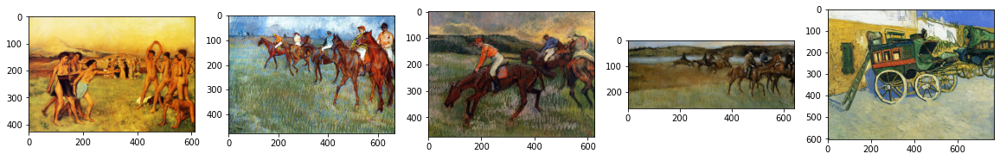

---------------------

Cluster 14:
Rembrandt                40
Pierre-Auguste_Renoir    25
Sandro_Botticelli        16
Raphael                  14
Edgar_Degas               8
Francisco_Goya            7
Peter_Paul_Rubens         6
Titian                    5
Diego_Velazquez           4
Frida_Kahlo               4
Camille_Pissarro          4
Jan_van_Eyck              4
Albrecht_Dürer            3
Leonardo_da_Vinci         3
Amedeo_Modigliani         2
Piet_Mondrian             2
Caravaggio                2
Eugene_Delacroix          2
El_Greco                  2
Gustave_Courbet           1
Salvador_Dali             1
Pablo_Picasso             1
Paul_Gauguin              1
Mikhail_Vrubel            1
William_Turner            1
Edvard_Munch              1
Vasiliy_Kandinskiy        1
Claude_Monet              1
Kazimir_Malevich          1
Gustav_Klimt              1
Name: artist, dtype: int64
Cluster 14 entropy: 2.6968554459546654
Cluster 14 probability: 0.019628964691801316


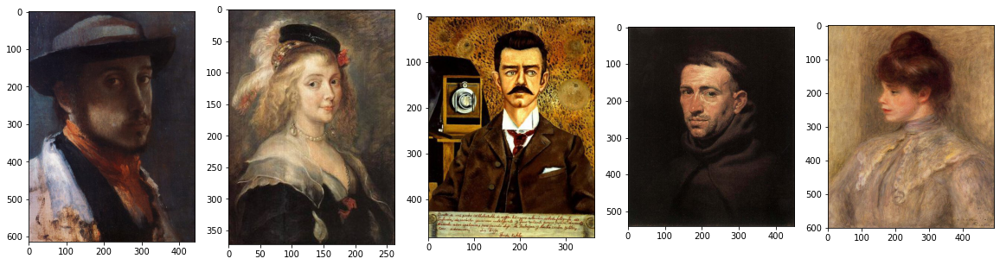

---------------------

Cluster 15:
Vincent_van_Gogh         89
Alfred_Sisley            86
Paul_Gauguin             40
Pierre-Auguste_Renoir    40
Gustav_Klimt             36
Camille_Pissarro         32
Claude_Monet             27
Henri_Rousseau           18
Rene_Magritte            15
Jackson_Pollock          14
Edgar_Degas              13
Georges_Seurat           12
Gustave_Courbet           7
Pieter_Bruegel            7
Marc_Chagall              7
Kazimir_Malevich          6
Piet_Mondrian             5
Mikhail_Vrubel            5
Hieronymus_Bosch          4
Sandro_Botticelli         4
William_Turner            3
Pablo_Picasso             3
Andy_Warhol               3
Henri_Matisse             3
Edouard_Manet             2
Leonardo_da_Vinci         2
Jan_van_Eyck              2
Salvador_Dali             2
Francisco_Goya            2
Paul_Cezanne              2
Albrecht_Dürer            1
Peter_Paul_Rubens         1
Diego_Rivera              1
Vasiliy_Kandinskiy        1
Raphael      

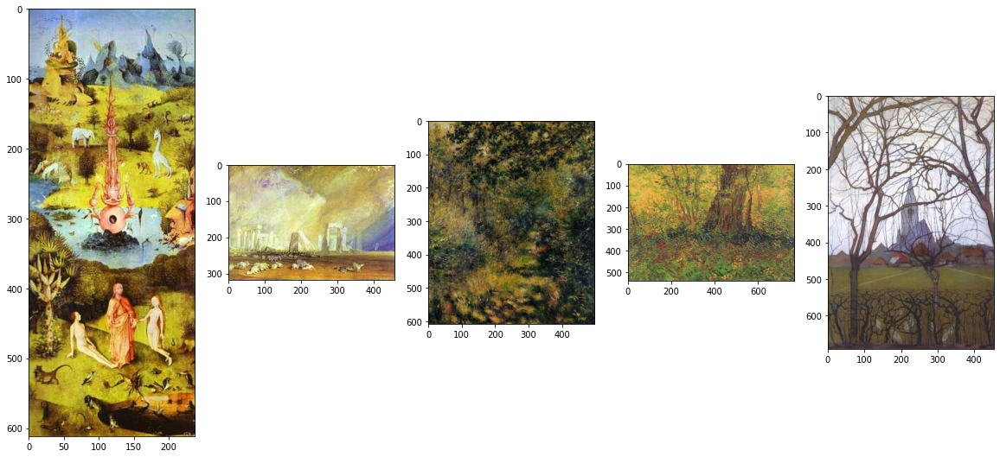

---------------------

Cluster 16:
Vincent_van_Gogh         40
Alfred_Sisley            35
Camille_Pissarro         12
Paul_Gauguin              9
Gustav_Klimt              7
Henri_Rousseau            6
Paul_Klee                 4
Pablo_Picasso             3
Marc_Chagall              3
Pierre-Auguste_Renoir     3
William_Turner            3
Mikhail_Vrubel            2
Diego_Velazquez           2
Albrecht_Dürer            2
Pieter_Bruegel            2
Claude_Monet              2
Georges_Seurat            1
Hieronymus_Bosch          1
Edgar_Degas               1
Rembrandt                 1
Vasiliy_Kandinskiy        1
Piet_Mondrian             1
Francisco_Goya            1
Sandro_Botticelli         1
Jan_van_Eyck              1
Name: artist, dtype: int64
Cluster 16 entropy: 2.3891314531661343
Cluster 16 probability: 0.017235188509874325


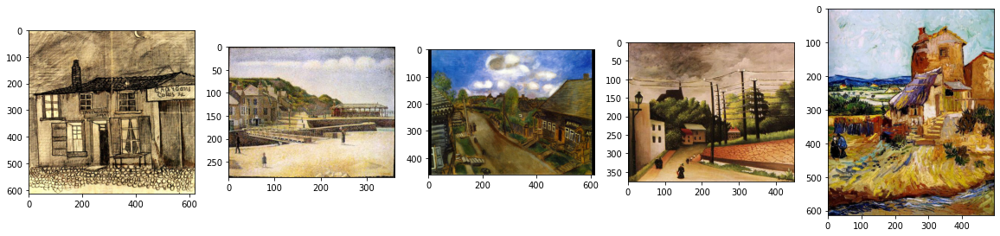

---------------------

Cluster 17:
Sandro_Botticelli        21
Rembrandt                10
Raphael                   7
Hieronymus_Bosch          5
Andrei_Rublev             3
Frida_Kahlo               2
Pierre-Auguste_Renoir     2
Marc_Chagall              2
Mikhail_Vrubel            2
Pablo_Picasso             2
Pieter_Bruegel            1
El_Greco                  1
Giotto_di_Bondone         1
Albrecht_Dürer            1
Titian                    1
Francisco_Goya            1
Camille_Pissarro          1
Michelangelo              1
Caravaggio                1
Name: artist, dtype: int64
Cluster 17 entropy: 2.3458227868295785
Cluster 17 probability: 0.007779772591262717


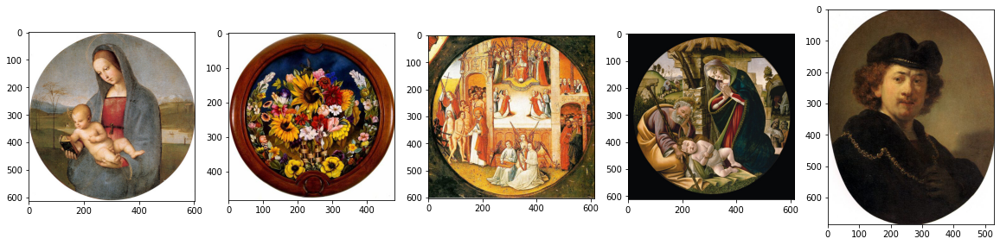

---------------------

Cluster 18:
Pierre-Auguste_Renoir        33
Albrecht_Dürer               16
Edgar_Degas                  15
Rembrandt                    15
Pablo_Picasso                13
Vincent_van_Gogh             13
Frida_Kahlo                  12
Leonardo_da_Vinci             8
Mikhail_Vrubel                8
Francisco_Goya                6
Edouard_Manet                 5
Jan_van_Eyck                  5
Paul_Gauguin                  4
Sandro_Botticelli             4
Amedeo_Modigliani             4
Rene_Magritte                 3
Peter_Paul_Rubens             3
El_Greco                      3
Salvador_Dali                 3
Gustave_Courbet               3
Andy_Warhol                   2
Diego_Rivera                  2
Kazimir_Malevich              2
Raphael                       1
Henri_Rousseau                1
Edvard_Munch                  1
Piet_Mondrian                 1
Hieronymus_Bosch              1
Eugene_Delacroix              1
Diego_Velazquez               1
Gusta

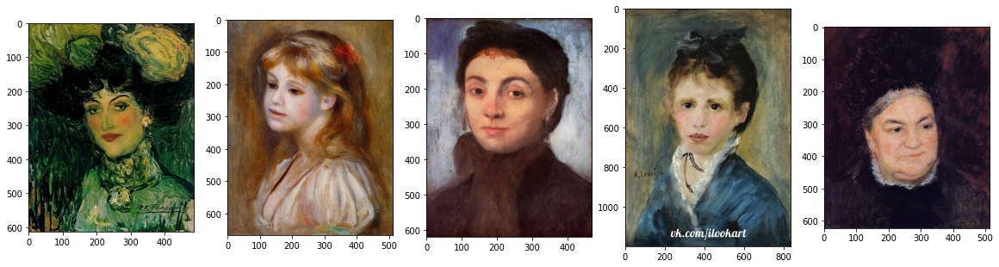

---------------------

Cluster 19:
Pierre-Auguste_Renoir        68
Marc_Chagall                 49
Edgar_Degas                  26
Vincent_van_Gogh             14
Paul_Gauguin                 13
Vasiliy_Kandinskiy           13
Paul_Klee                    10
Henri_Matisse                 8
Pablo_Picasso                 7
William_Turner                6
Piet_Mondrian                 5
Claude_Monet                  5
Henri_de_Toulouse-Lautrec     4
Rene_Magritte                 4
Frida_Kahlo                   4
Jackson_Pollock               2
Joan_Miro                     2
Edvard_Munch                  2
Paul_Cezanne                  2
Sandro_Botticelli             1
Peter_Paul_Rubens             1
Andy_Warhol                   1
Francisco_Goya                1
Mikhail_Vrubel                1
Diego_Rivera                  1
Alfred_Sisley                 1
Edouard_Manet                 1
Gustav_Klimt                  1
Name: artist, dtype: int64
Cluster 19 entropy: 2.4967091943363657
Clu

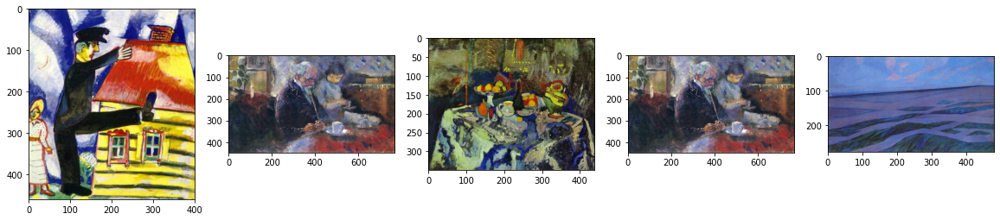

---------------------

Cluster 20:
Michelangelo         18
Pieter_Bruegel       15
Salvador_Dali         7
Albrecht_Dürer        7
Hieronymus_Bosch      5
Sandro_Botticelli     4
Pablo_Picasso         4
Francisco_Goya        3
Henri_Matisse         3
Vincent_van_Gogh      3
Andrei_Rublev         2
Paul_Gauguin          2
Joan_Miro             2
El_Greco              1
Rene_Magritte         1
Edvard_Munch          1
Piet_Mondrian         1
Rembrandt             1
Diego_Velazquez       1
Jan_van_Eyck          1
Peter_Paul_Rubens     1
Paul_Cezanne          1
Mikhail_Vrubel        1
Raphael               1
Paul_Klee             1
Giotto_di_Bondone     1
Name: artist, dtype: int64
Cluster 20 entropy: 2.737858122683425
Cluster 20 probability: 0.010532615200478756


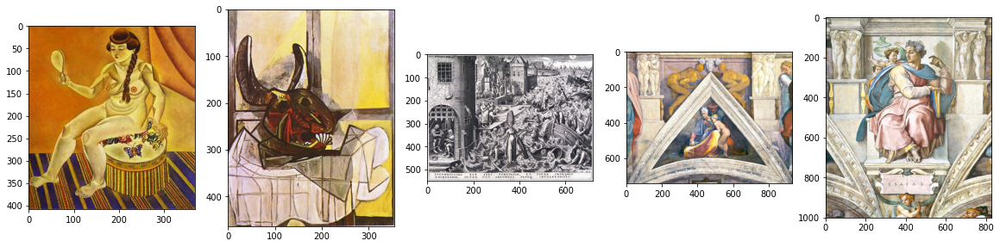

---------------------

Cluster 21:
Michelangelo    5
Name: artist, dtype: int64
Cluster 21 entropy: 0.0
Cluster 21 probability: 0.0005984440454817474


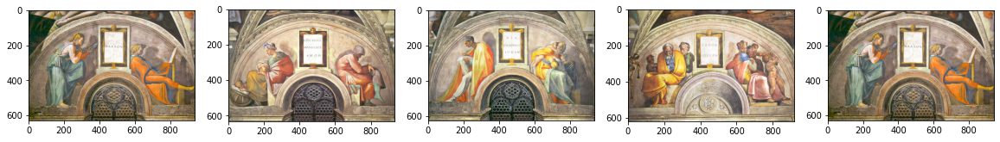

---------------------

Cluster 22:
Vincent_van_Gogh         108
Paul_Gauguin              10
Hieronymus_Bosch           9
Georges_Seurat             9
Claude_Monet               6
Pierre-Auguste_Renoir      5
Salvador_Dali              4
Vasiliy_Kandinskiy         4
Alfred_Sisley              4
Edvard_Munch               4
Pieter_Bruegel             3
Paul_Cezanne               2
Henri_Matisse              2
Edgar_Degas                2
Gustav_Klimt               2
Kazimir_Malevich           2
Joan_Miro                  2
Diego_Rivera               1
Francisco_Goya             1
Sandro_Botticelli          1
El_Greco                   1
Piet_Mondrian              1
Gustave_Courbet            1
Camille_Pissarro           1
Marc_Chagall               1
Andy_Warhol                1
Paul_Klee                  1
Henri_Rousseau             1
Name: artist, dtype: int64
Cluster 22 entropy: 1.9568892106173732
Cluster 22 probability: 0.022621184919210054


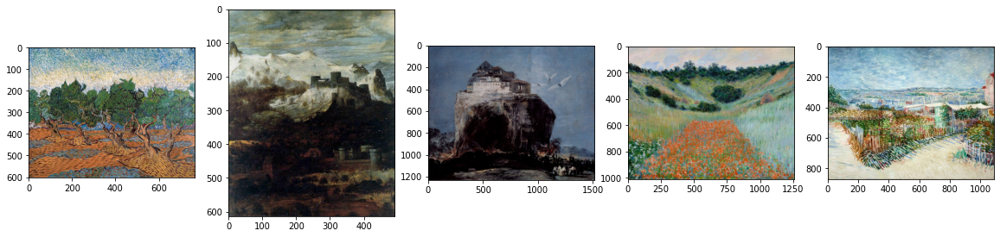

---------------------

Cluster 23:
Frida_Kahlo    8
Raphael        1
Name: artist, dtype: int64
Cluster 23 entropy: 0.34883209584303193
Cluster 23 probability: 0.0010771992818671453


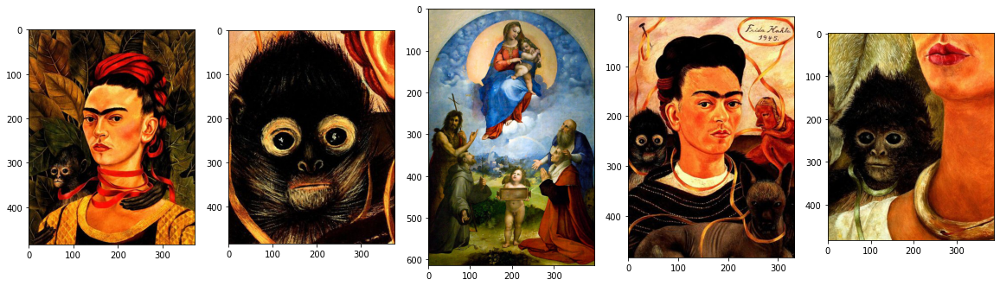

---------------------

Cluster 24:
Titian                   41
Raphael                  27
Peter_Paul_Rubens        18
Pierre-Auguste_Renoir    12
Pablo_Picasso            11
Rene_Magritte            10
Caravaggio                9
Sandro_Botticelli         9
Michelangelo              8
Leonardo_da_Vinci         8
Gustave_Courbet           7
Rembrandt                 6
Salvador_Dali             4
Edouard_Manet             4
Paul_Gauguin              3
Georges_Seurat            2
Diego_Rivera              2
Francisco_Goya            2
Diego_Velazquez           1
Albrecht_Dürer            1
Edgar_Degas               1
Henri_Rousseau            1
Frida_Kahlo               1
Amedeo_Modigliani         1
Jan_van_Eyck              1
Name: artist, dtype: int64
Cluster 24 entropy: 2.677390228774639
Cluster 24 probability: 0.022740873728306403


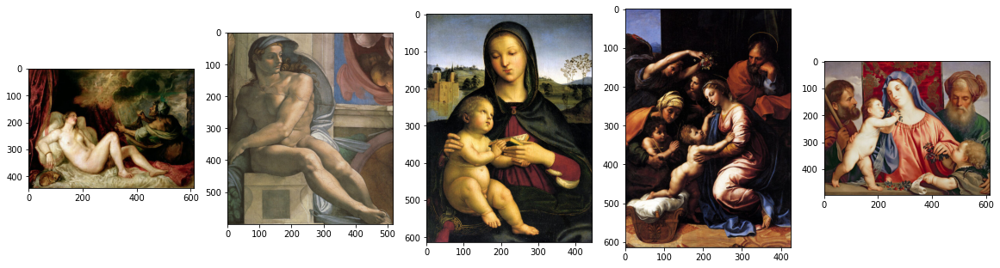

---------------------

Cluster 25:
Giotto_di_Bondone    52
Sandro_Botticelli     4
Titian                2
Diego_Rivera          2
Albrecht_Dürer        1
Peter_Paul_Rubens     1
Mikhail_Vrubel        1
Vincent_van_Gogh      1
Edgar_Degas           1
Raphael               1
Hieronymus_Bosch      1
Name: artist, dtype: int64
Cluster 25 entropy: 1.013909939794644
Cluster 25 probability: 0.008019150209455416


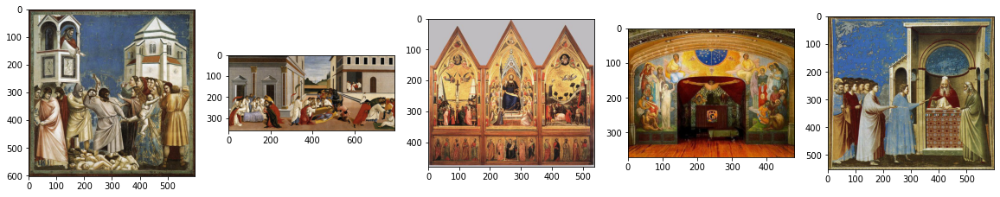

---------------------

Cluster 26:
El_Greco                 14
Titian                    9
Peter_Paul_Rubens         5
Rembrandt                 5
Vincent_van_Gogh          3
Edouard_Manet             3
Pablo_Picasso             3
Pierre-Auguste_Renoir     2
Albrecht_Dürer            2
Giotto_di_Bondone         2
Mikhail_Vrubel            2
Edgar_Degas               2
Marc_Chagall              1
Raphael                   1
Pieter_Bruegel            1
Kazimir_Malevich          1
Frida_Kahlo               1
Diego_Velazquez           1
Francisco_Goya            1
Gustave_Courbet           1
Andrei_Rublev             1
Gustav_Klimt              1
Jan_van_Eyck              1
Name: artist, dtype: int64
Cluster 26 entropy: 2.7203540067313274
Cluster 26 probability: 0.0075403949730700175


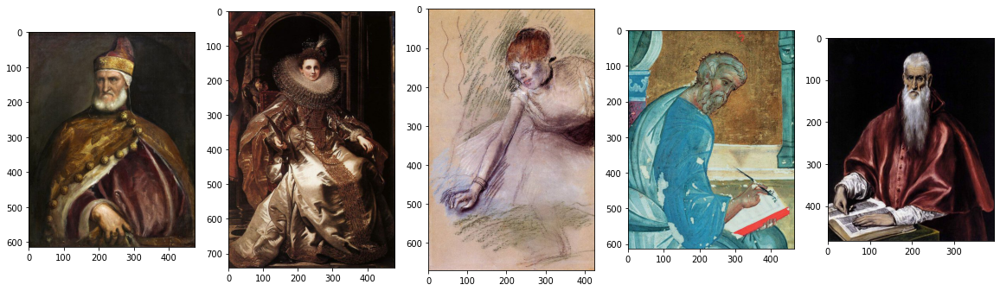

---------------------

Cluster 27:
Edgar_Degas         11
Hieronymus_Bosch     3
Pablo_Picasso        1
Name: artist, dtype: int64
Cluster 27 entropy: 0.7298712099831165
Cluster 27 probability: 0.0017953321364452424


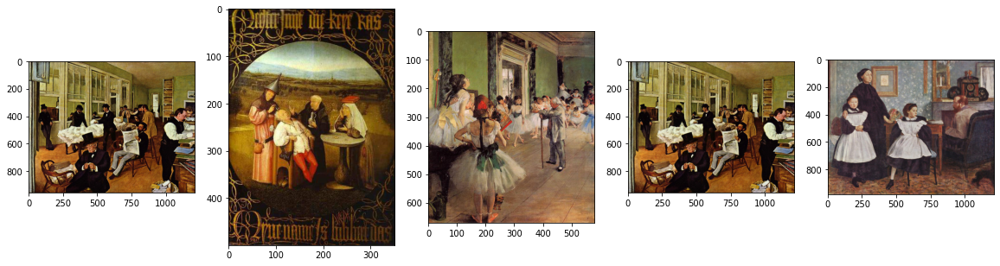

---------------------

Cluster 28:
Vincent_van_Gogh     49
Rembrandt             4
Paul_Gauguin          4
Giotto_di_Bondone     2
Henri_Matisse         2
El_Greco              1
Paul_Klee             1
Andrei_Rublev         1
Edgar_Degas           1
Name: artist, dtype: int64
Cluster 28 entropy: 1.0272774511476432
Cluster 28 probability: 0.007779772591262717


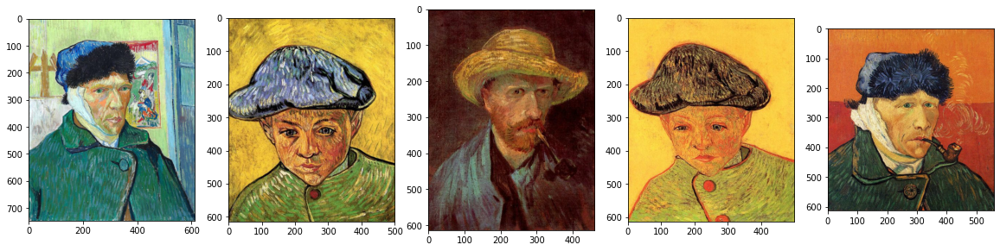

---------------------

Cluster 29:
Edgar_Degas                  74
Henri_de_Toulouse-Lautrec     8
Paul_Gauguin                  6
Rene_Magritte                 6
Vincent_van_Gogh              5
Rembrandt                     4
Pierre-Auguste_Renoir         4
Frida_Kahlo                   4
Pablo_Picasso                 3
Albrecht_Dürer                3
Diego_Rivera                  3
Kazimir_Malevich              2
Gustav_Klimt                  2
Edvard_Munch                  2
Pieter_Bruegel                2
Edouard_Manet                 2
Henri_Rousseau                2
Raphael                       2
Amedeo_Modigliani             1
Giotto_di_Bondone             1
Henri_Matisse                 1
Eugene_Delacroix              1
Michelangelo                  1
Camille_Pissarro              1
Paul_Klee                     1
Titian                        1
Francisco_Goya                1
Sandro_Botticelli             1
Name: artist, dtype: int64
Cluster 29 entropy: 2.1857038837236034
Clu

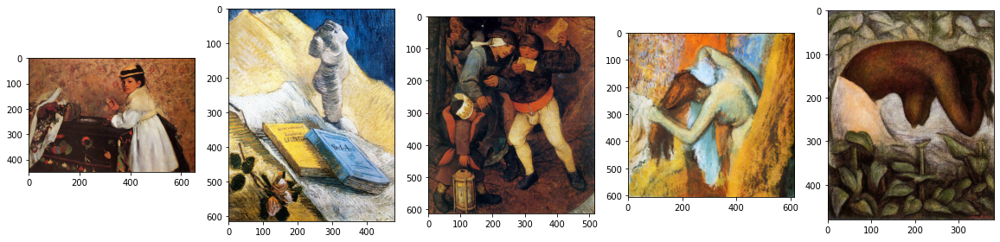

---------------------

Cluster 30:
Edgar_Degas    4
Name: artist, dtype: int64
Cluster 30 entropy: 0.0
Cluster 30 probability: 0.00047875523638539794


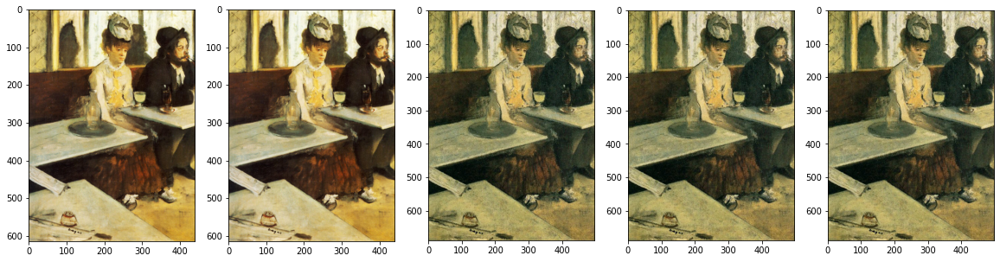

---------------------

Cluster 31:
Paul_Klee                    49
Pablo_Picasso                33
Joan_Miro                    30
Vincent_van_Gogh             28
Vasiliy_Kandinskiy           25
Henri_Matisse                18
Marc_Chagall                 17
Andy_Warhol                  14
Kazimir_Malevich             12
Paul_Gauguin                 12
Pieter_Bruegel               11
Henri_de_Toulouse-Lautrec     8
Albrecht_Dürer                8
Piet_Mondrian                 5
Rene_Magritte                 4
Mikhail_Vrubel                3
Frida_Kahlo                   2
Henri_Rousseau                2
Hieronymus_Bosch              1
Gustav_Klimt                  1
Leonardo_da_Vinci             1
Salvador_Dali                 1
Andrei_Rublev                 1
Diego_Rivera                  1
Name: artist, dtype: int64
Cluster 31 entropy: 2.670011576542005
Cluster 31 probability: 0.034350688210652305


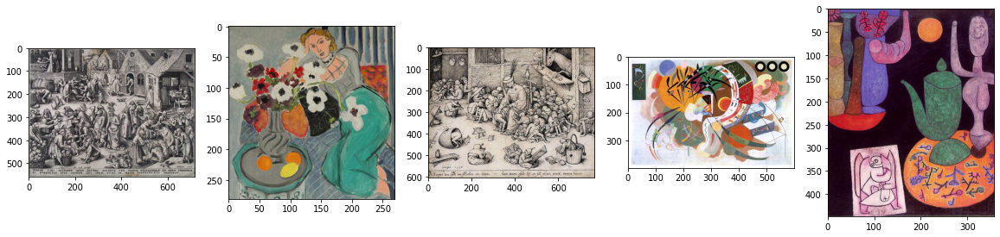

---------------------

Cluster 32:
Giotto_di_Bondone        8
Alfred_Sisley            6
Camille_Pissarro         5
Vincent_van_Gogh         4
Pieter_Bruegel           4
Sandro_Botticelli        4
Pierre-Auguste_Renoir    3
Michelangelo             3
Jan_van_Eyck             2
Claude_Monet             1
Albrecht_Dürer           1
Francisco_Goya           1
Raphael                  1
William_Turner           1
Leonardo_da_Vinci        1
Gustav_Klimt             1
Name: artist, dtype: int64
Cluster 32 entropy: 2.5232766326294263
Cluster 32 probability: 0.005505685218432077


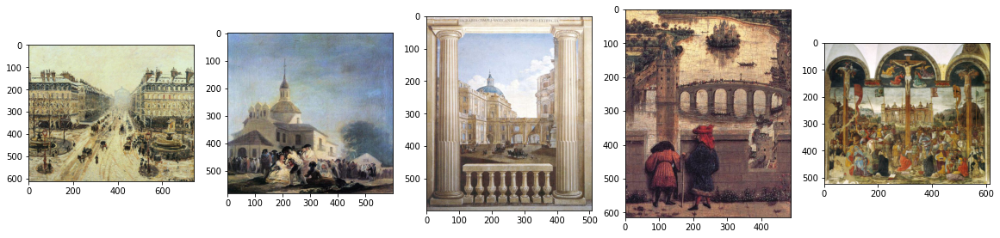

---------------------

Cluster 33:
Titian                   35
Pierre-Auguste_Renoir    23
Raphael                  12
Francisco_Goya           11
Rembrandt                11
Peter_Paul_Rubens         5
Pablo_Picasso             5
Edgar_Degas               4
El_Greco                  3
Leonardo_da_Vinci         2
Caravaggio                2
Frida_Kahlo               2
Gustave_Courbet           1
Salvador_Dali             1
Giotto_di_Bondone         1
Rene_Magritte             1
Piet_Mondrian             1
Name: artist, dtype: int64
Cluster 33 entropy: 2.2189883974845075
Cluster 33 probability: 0.01436265709156194


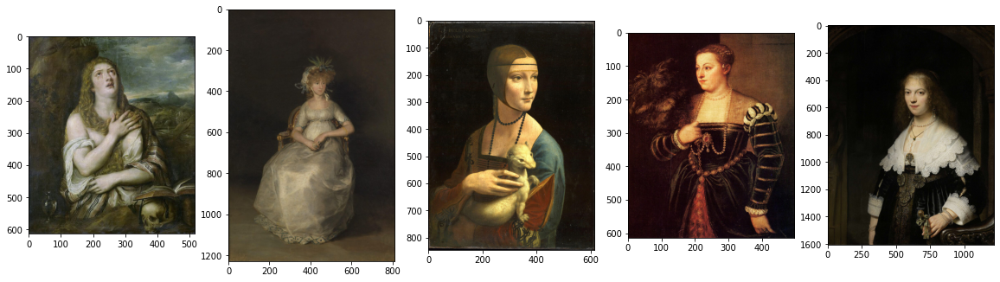

---------------------

Cluster 34:
Vincent_van_Gogh         72
Edgar_Degas              13
Piet_Mondrian             9
Alfred_Sisley             8
Claude_Monet              8
Edouard_Manet             7
William_Turner            6
Georges_Seurat            6
Paul_Gauguin              6
Pierre-Auguste_Renoir     5
Henri_Matisse             4
Pablo_Picasso             4
Rene_Magritte             3
Pieter_Bruegel            3
Mikhail_Vrubel            3
Marc_Chagall              2
Paul_Klee                 2
Gustave_Courbet           2
Camille_Pissarro          2
Rembrandt                 2
Joan_Miro                 1
Albrecht_Dürer            1
Henri_Rousseau            1
Frida_Kahlo               1
Hieronymus_Bosch          1
Kazimir_Malevich          1
Salvador_Dali             1
Titian                    1
Vasiliy_Kandinskiy        1
Name: artist, dtype: int64
Cluster 34 entropy: 2.465143333542165
Cluster 34 probability: 0.02106523040095751


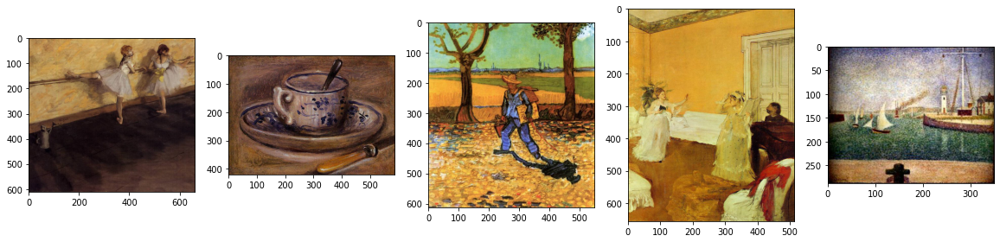

---------------------

Cluster 35:
Peter_Paul_Rubens    39
El_Greco             32
Titian               17
Edgar_Degas           9
Eugene_Delacroix      6
Francisco_Goya        3
Sandro_Botticelli     3
Raphael               3
Salvador_Dali         3
Diego_Rivera          2
Rene_Magritte         2
Edouard_Manet         2
Giotto_di_Bondone     2
Frida_Kahlo           2
Michelangelo          1
Leonardo_da_Vinci     1
Mikhail_Vrubel        1
Albrecht_Dürer        1
Paul_Cezanne          1
Diego_Velazquez       1
Vincent_van_Gogh      1
Hieronymus_Bosch      1
Rembrandt             1
Caravaggio            1
Name: artist, dtype: int64
Cluster 35 entropy: 2.293515687930176
Cluster 35 probability: 0.01615798922800718


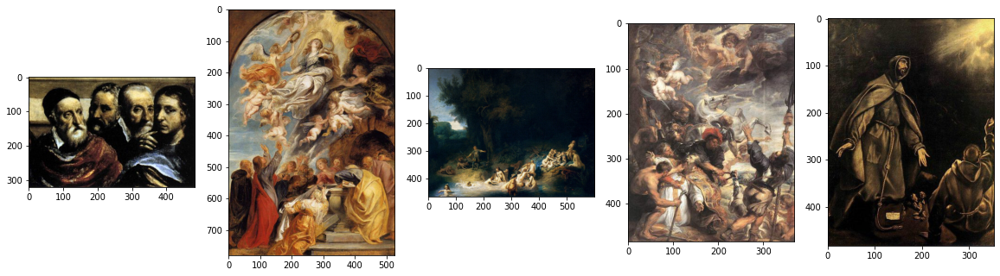

---------------------

Cluster 36:
Vincent_van_Gogh         21
Pierre-Auguste_Renoir    16
Paul_Gauguin             12
Paul_Cezanne              9
Henri_Matisse             5
Diego_Rivera              4
Frida_Kahlo               4
Alfred_Sisley             2
Gustave_Courbet           2
Francisco_Goya            2
Andy_Warhol               1
Pablo_Picasso             1
Claude_Monet              1
Rene_Magritte             1
Caravaggio                1
Edouard_Manet             1
Name: artist, dtype: int64
Cluster 36 entropy: 2.235868086399012
Cluster 36 probability: 0.009934171154997009


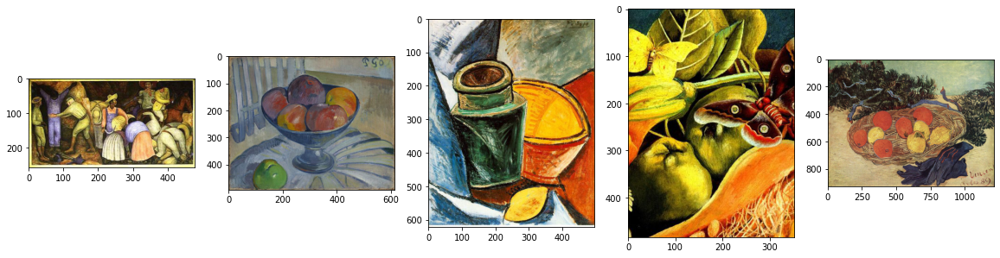

---------------------

Cluster 37:
Edgar_Degas          44
Sandro_Botticelli     4
Frida_Kahlo           2
Vincent_van_Gogh      2
Francisco_Goya        2
El_Greco              2
Raphael               2
Marc_Chagall          1
Leonardo_da_Vinci     1
Titian                1
Paul_Klee             1
Giotto_di_Bondone     1
Rene_Magritte         1
Diego_Rivera          1
Edvard_Munch          1
Name: artist, dtype: int64
Cluster 37 entropy: 1.4778215125948722
Cluster 37 probability: 0.007899461400359067


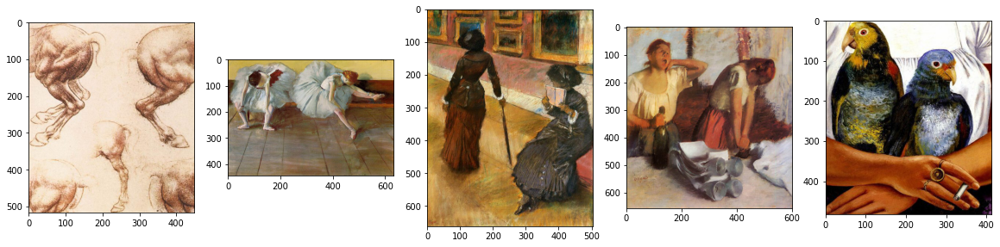

---------------------

Cluster 38:
Amedeo_Modigliani            21
Edgar_Degas                  18
Titian                       13
Francisco_Goya               11
Edouard_Manet                 8
Edvard_Munch                  7
Pierre-Auguste_Renoir         6
Henri_Matisse                 6
Paul_Cezanne                  6
Vincent_van_Gogh              5
Diego_Rivera                  5
Sandro_Botticelli             5
Frida_Kahlo                   5
Rembrandt                     5
Rene_Magritte                 3
Henri_de_Toulouse-Lautrec     3
Pablo_Picasso                 3
El_Greco                      3
Jan_van_Eyck                  2
Peter_Paul_Rubens             2
Albrecht_Dürer                2
Kazimir_Malevich              2
Raphael                       2
Eugene_Delacroix              1
Salvador_Dali                 1
Diego_Velazquez               1
Leonardo_da_Vinci             1
Marc_Chagall                  1
Henri_Rousseau                1
Name: artist, dtype: int64
Cluster 38

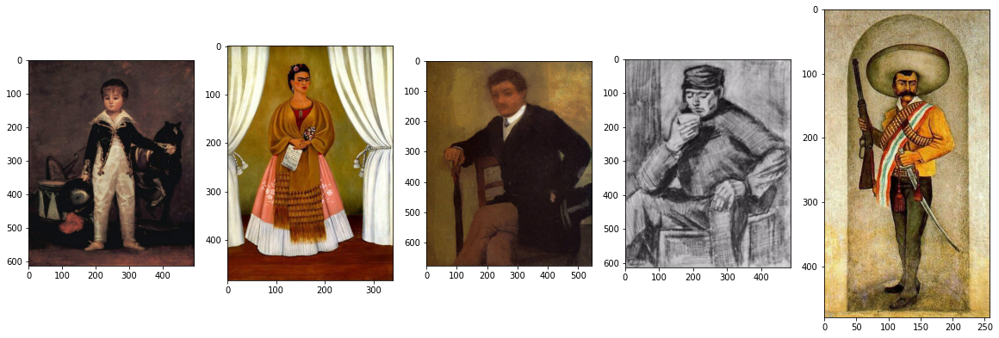

---------------------

Cluster 39:
Amedeo_Modigliani            81
Pablo_Picasso                37
Rene_Magritte                15
Frida_Kahlo                  13
Henri_Matisse                 9
Joan_Miro                     9
Kazimir_Malevich              8
Paul_Gauguin                  7
Andrei_Rublev                 7
Salvador_Dali                 7
Edgar_Degas                   6
Pieter_Bruegel                5
Diego_Rivera                  5
Hieronymus_Bosch              5
Gustav_Klimt                  4
Edvard_Munch                  4
Edouard_Manet                 3
Paul_Klee                     3
Andy_Warhol                   3
Jan_van_Eyck                  3
Vincent_van_Gogh              3
Pierre-Auguste_Renoir         2
William_Turner                1
Henri_de_Toulouse-Lautrec     1
Francisco_Goya                1
Diego_Velazquez               1
Caravaggio                    1
Piet_Mondrian                 1
Michelangelo                  1
Georges_Seurat                1
Marc_

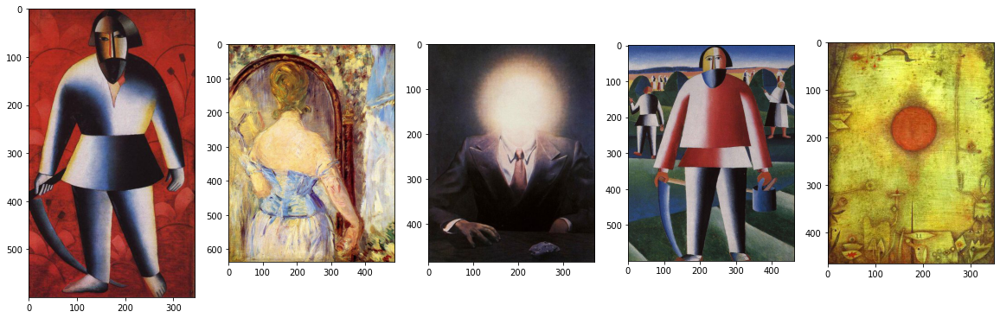

---------------------

Cluster 40:
Vincent_van_Gogh             45
Marc_Chagall                 23
Gustav_Klimt                 20
Pablo_Picasso                20
Paul_Gauguin                 19
Paul_Klee                    18
Mikhail_Vrubel               14
Henri_Matisse                14
Andrei_Rublev                14
Jan_van_Eyck                  9
Andy_Warhol                   8
Vasiliy_Kandinskiy            8
Salvador_Dali                 7
Edgar_Degas                   7
Piet_Mondrian                 6
Joan_Miro                     5
Edvard_Munch                  4
Leonardo_da_Vinci             4
Frida_Kahlo                   4
Jackson_Pollock               3
Diego_Rivera                  3
Pierre-Auguste_Renoir         3
Rene_Magritte                 3
Giotto_di_Bondone             3
Albrecht_Dürer                2
Sandro_Botticelli             2
Hieronymus_Bosch              2
Titian                        1
Kazimir_Malevich              1
Michelangelo                  1
Peter

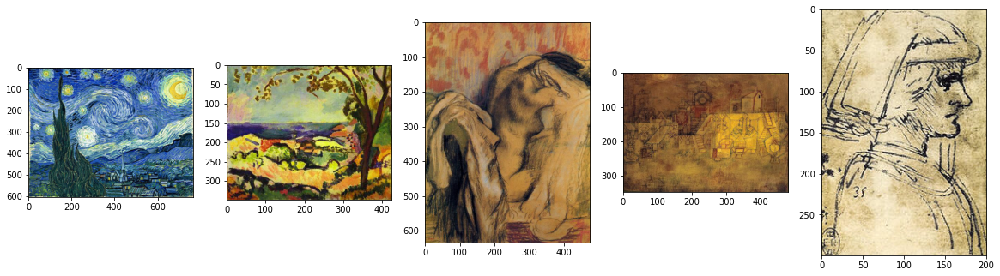

---------------------

Cluster 41:
Albrecht_Dürer               158
Leonardo_da_Vinci             76
Vincent_van_Gogh              70
Marc_Chagall                  34
Pablo_Picasso                 31
Francisco_Goya                22
Paul_Gauguin                  15
Mikhail_Vrubel                15
Gustav_Klimt                  15
Edgar_Degas                   13
Salvador_Dali                 11
Pieter_Bruegel                 8
William_Turner                 5
Pierre-Auguste_Renoir          5
Paul_Klee                      4
Rene_Magritte                  3
Joan_Miro                      3
Henri_de_Toulouse-Lautrec      3
Andy_Warhol                    3
Kazimir_Malevich               2
Henri_Matisse                  2
Alfred_Sisley                  2
Amedeo_Modigliani              2
Jan_van_Eyck                   2
Peter_Paul_Rubens              2
Piet_Mondrian                  1
Paul_Cezanne                   1
Claude_Monet                   1
Caravaggio                     1
Camille_

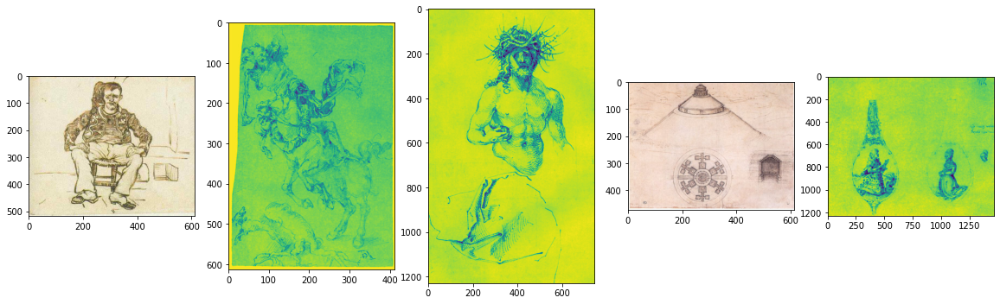

---------------------

Cluster 42:
Edgar_Degas                  27
Titian                       20
Caravaggio                   14
Paul_Gauguin                 13
Hieronymus_Bosch             10
Rembrandt                     9
Raphael                       9
Peter_Paul_Rubens             8
Francisco_Goya                7
Sandro_Botticelli             7
Pablo_Picasso                 7
Frida_Kahlo                   6
Vincent_van_Gogh              5
Mikhail_Vrubel                4
Pierre-Auguste_Renoir         4
Albrecht_Dürer                4
Jan_van_Eyck                  4
Rene_Magritte                 4
Andy_Warhol                   3
Marc_Chagall                  3
Henri_de_Toulouse-Lautrec     3
Eugene_Delacroix              3
El_Greco                      3
Edvard_Munch                  3
Diego_Rivera                  2
Kazimir_Malevich              2
Diego_Velazquez               2
Gustave_Courbet               2
Pieter_Bruegel                2
Paul_Cezanne                  2
Salva

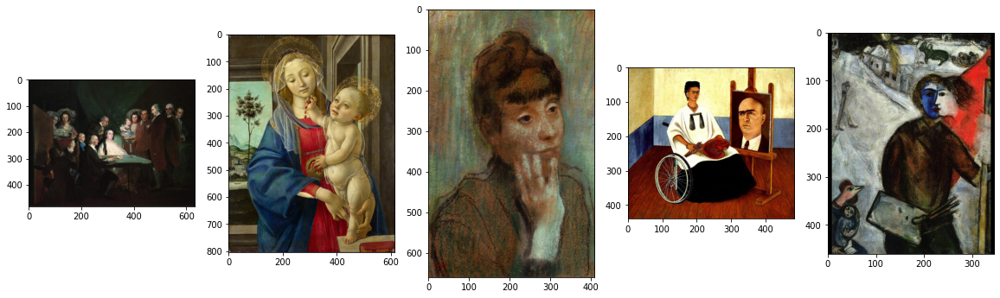

---------------------

Cluster 43:
Paul_Gauguin                 38
Vincent_van_Gogh             26
Pieter_Bruegel               18
Sandro_Botticelli            17
Pablo_Picasso                14
Hieronymus_Bosch             14
Edgar_Degas                  14
Francisco_Goya                9
Rembrandt                     9
Peter_Paul_Rubens             9
Jan_van_Eyck                  9
Salvador_Dali                 8
Henri_de_Toulouse-Lautrec     7
Giotto_di_Bondone             7
Albrecht_Dürer                6
Mikhail_Vrubel                6
Titian                        5
Andrei_Rublev                 5
Raphael                       3
Michelangelo                  3
Marc_Chagall                  3
Henri_Rousseau                3
Edvard_Munch                  3
Paul_Cezanne                  3
Alfred_Sisley                 3
Gustave_Courbet               2
Camille_Pissarro              2
Diego_Velazquez               1
Henri_Matisse                 1
Paul_Klee                     1
Pierr

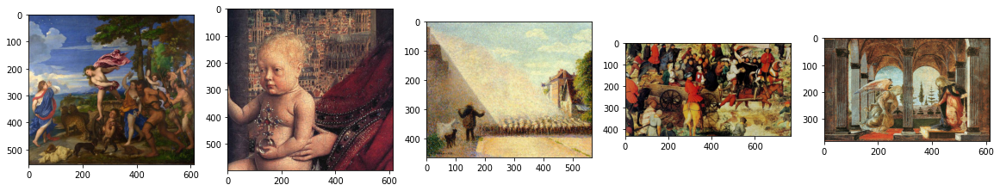

---------------------

Cluster 44:
Edgar_Degas                  18
Edouard_Manet                 9
Titian                        8
Francisco_Goya                8
Vincent_van_Gogh              6
Rembrandt                     6
Sandro_Botticelli             5
Pierre-Auguste_Renoir         5
Peter_Paul_Rubens             5
Paul_Gauguin                  5
Pablo_Picasso                 4
Edvard_Munch                  3
Pieter_Bruegel                2
Henri_Matisse                 2
Frida_Kahlo                   2
Rene_Magritte                 2
Caravaggio                    2
El_Greco                      2
Henri_de_Toulouse-Lautrec     2
Gustave_Courbet               2
Hieronymus_Bosch              1
Eugene_Delacroix              1
Marc_Chagall                  1
Mikhail_Vrubel                1
Camille_Pissarro              1
Diego_Velazquez               1
Andy_Warhol                   1
Kazimir_Malevich              1
Name: artist, dtype: int64
Cluster 44 entropy: 2.9776464659621054
Clu

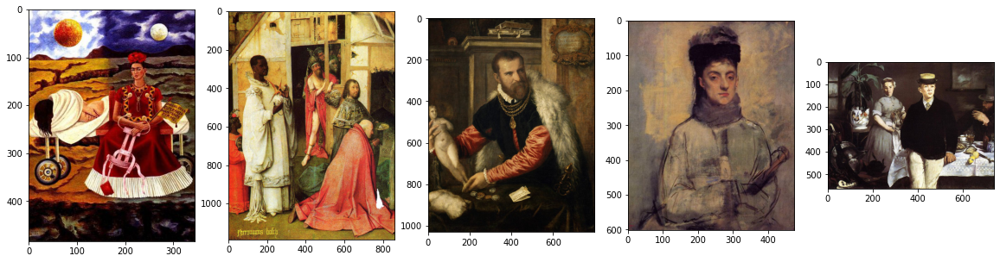

---------------------

Cluster 45:
Albrecht_Dürer               40
Vincent_van_Gogh             25
Francisco_Goya               25
Giotto_di_Bondone            11
Jan_van_Eyck                  9
Edouard_Manet                 7
Edvard_Munch                  6
Sandro_Botticelli             6
Edgar_Degas                   5
Mikhail_Vrubel                5
Leonardo_da_Vinci             5
Pablo_Picasso                 4
Diego_Velazquez               3
Henri_Matisse                 3
Henri_de_Toulouse-Lautrec     3
Amedeo_Modigliani             2
Paul_Gauguin                  2
Henri_Rousseau                2
Kazimir_Malevich              2
Eugene_Delacroix              2
Pierre-Auguste_Renoir         2
Salvador_Dali                 1
Caravaggio                    1
Andrei_Rublev                 1
El_Greco                      1
Gustave_Courbet               1
Rene_Magritte                 1
Andy_Warhol                   1
Claude_Monet                  1
Pieter_Bruegel                1
Hiero

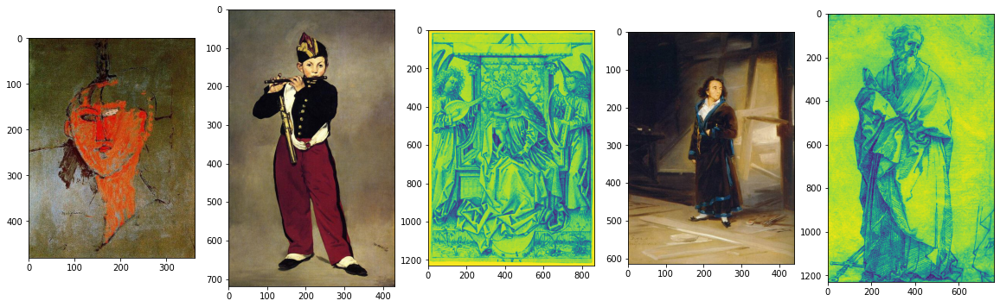

---------------------

Cluster 46:
Edgar_Degas                  58
Francisco_Goya               29
Vincent_van_Gogh             16
Rembrandt                    15
Titian                       10
Henri_Matisse                 8
Rene_Magritte                 8
Pierre-Auguste_Renoir         6
Mikhail_Vrubel                6
Pablo_Picasso                 6
Salvador_Dali                 5
Sandro_Botticelli             4
El_Greco                      4
Paul_Cezanne                  4
Hieronymus_Bosch              4
Frida_Kahlo                   3
Edouard_Manet                 3
Raphael                       2
Caravaggio                    2
Henri_de_Toulouse-Lautrec     2
Andrei_Rublev                 2
Henri_Rousseau                2
Eugene_Delacroix              2
Albrecht_Dürer                1
Paul_Klee                     1
Peter_Paul_Rubens             1
Marc_Chagall                  1
Giotto_di_Bondone             1
Pieter_Bruegel                1
Edvard_Munch                  1
Paul_

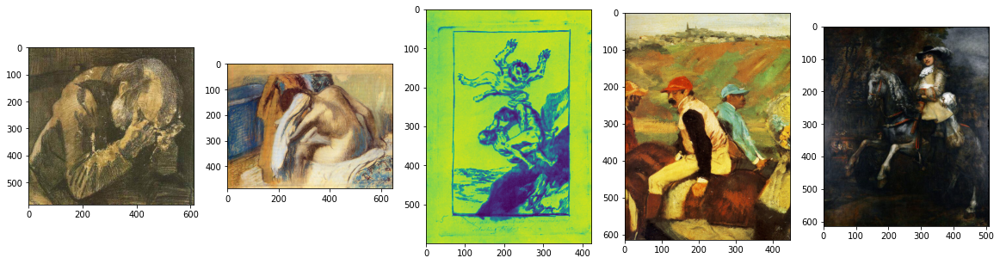

---------------------

Cluster 47:
Marc_Chagall                 58
Andy_Warhol                  54
Pablo_Picasso                18
Salvador_Dali                13
Rene_Magritte                13
Francisco_Goya                9
Joan_Miro                     8
Vincent_van_Gogh              7
Edgar_Degas                   7
Henri_Matisse                 5
Vasiliy_Kandinskiy            5
Paul_Gauguin                  4
Edvard_Munch                  4
Kazimir_Malevich              3
Frida_Kahlo                   3
Amedeo_Modigliani             3
Diego_Rivera                  3
Mikhail_Vrubel                3
Jan_van_Eyck                  2
Titian                        2
Jackson_Pollock               2
Henri_de_Toulouse-Lautrec     2
Pierre-Auguste_Renoir         1
Peter_Paul_Rubens             1
Paul_Klee                     1
Gustave_Courbet               1
Albrecht_Dürer                1
Gustav_Klimt                  1
Caravaggio                    1
Leonardo_da_Vinci             1
Name:

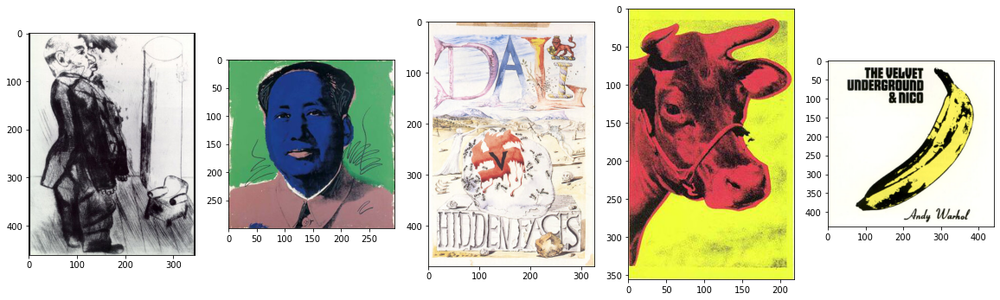

---------------------

Cluster 48:
Mikhail_Vrubel               63
Vincent_van_Gogh             56
Edgar_Degas                  55
Paul_Gauguin                 44
Francisco_Goya               41
Andrei_Rublev                40
Pablo_Picasso                37
Pieter_Bruegel               23
Amedeo_Modigliani            19
Rembrandt                    17
Titian                       16
Henri_Matisse                14
Albrecht_Dürer               14
Henri_de_Toulouse-Lautrec    13
Paul_Klee                    13
Salvador_Dali                12
Rene_Magritte                12
Leonardo_da_Vinci             9
Paul_Cezanne                  8
Piet_Mondrian                 7
Hieronymus_Bosch              7
Pierre-Auguste_Renoir         6
Gustav_Klimt                  5
Edouard_Manet                 5
Edvard_Munch                  5
Gustave_Courbet               5
William_Turner                5
Frida_Kahlo                   5
Giotto_di_Bondone             4
Kazimir_Malevich              4
Camil

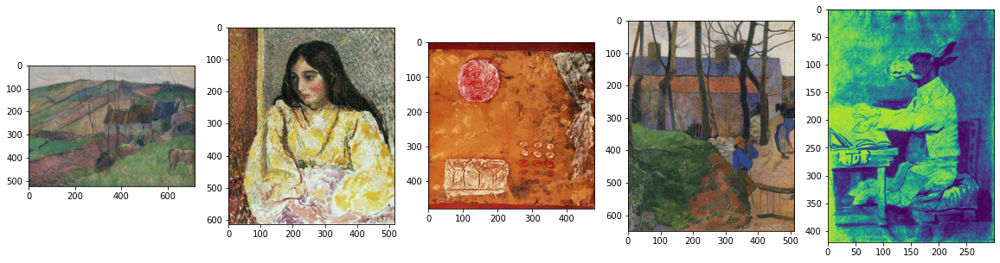

---------------------

Cluster 49:
Pieter_Bruegel       9
Hieronymus_Bosch     8
Diego_Rivera         7
Peter_Paul_Rubens    5
Michelangelo         3
Francisco_Goya       2
Edgar_Degas          2
El_Greco             1
Giotto_di_Bondone    1
Eugene_Delacroix     1
Vincent_van_Gogh     1
Andy_Warhol          1
Salvador_Dali        1
Name: artist, dtype: int64
Cluster 49 entropy: 2.210347243919881
Cluster 49 probability: 0.005026929982046679


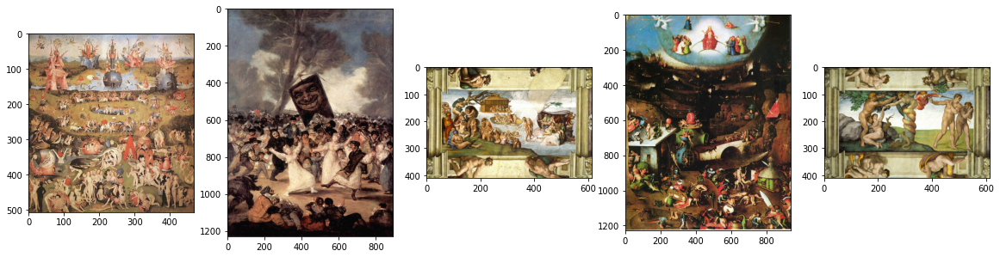

---------------------



In [74]:
cluster_entropies=[]
cluster_probabilities=[]
for i in range(50):
    print(f"Cluster {i}:")
    subdf = df[df.cluster==i]
    subcounts = subdf['artist'].value_counts()
    print(subcounts)
    cluster_entropy=entropy(subcounts/subcounts.sum())
    cluster_entropies.append(cluster_entropy)
    cluster_probability=subdf.shape[0]/df.shape[0]
    cluster_probabilities.append(cluster_probability)
    print(f"Cluster {i} entropy: {cluster_entropy}")
    print(f"Cluster {i} probability: {cluster_probability}")
    sample_images = [PIL.Image.open(subdf.sample(5, replace=(subdf.shape[0]<5)).path.iloc[pic]) for pic in range(5)] # sample with replacement if cluster has less than 5
    # for j in range(5):
    #     sample_images.append(PIL.Image.open(subdf.sample().path.iloc[0]))
    # display(*sample_images)
    plt.figure(figsize=(20,10))
    columns=5

    for i, image in enumerate(sample_images):
        plt.subplot(1, columns, i+1)
        plt.imshow(image)
    plt.show()
        # plt.figure()
        # plt.imshow(PIL.Image.open(subdf.sample().path.iloc[0]))
    print("---------------------\n")

In [80]:
print(f"Overall clustering entropy: {(np.array(cluster_entropies) * np.array(cluster_probabilities)).sum()}")

Overall clustering entropy: 2.61677199113968


In [84]:
cluster_df = df.groupby('cluster')['artist'].describe()
cluster_df.reset_index(inplace=True)
cluster_df['cluster_entropy'] = cluster_entropies
cluster_df

,cluster,count,unique,top,freq,cluster_entropy
0,0,2,2,Edouard_Manet,1,0.693147
1,1,195,25,Pablo_Picasso,53,2.434282
2,2,31,5,Piet_Mondrian,24,0.822522
3,3,261,26,Alfred_Sisley,110,2.185088
4,4,176,16,Edgar_Degas,132,1.144557
5,5,212,30,Rembrandt,38,2.875157
6,6,188,28,Albrecht_Dürer,31,2.808901
7,7,140,24,Pablo_Picasso,41,2.348363
8,8,191,36,Pablo_Picasso,16,3.287357
9,9,143,34,Salvador_Dali,11,3.185635


In [ ]:
from sklearn.preprocessing import OrdinalEncoder

In [ ]:
from sklearn import metrics

In [ ]:
enc = OrdinalEncoder()

In [ ]:
enc.fit(df[['artist']])

OrdinalEncoder()

In [ ]:
cluster0['artist']

10      Pierre-Auguste_Renoir
98      Pierre-Auguste_Renoir
105     Pierre-Auguste_Renoir
116               Edgar_Degas
120               Edgar_Degas
                ...          
8246              Edgar_Degas
8272             Claude_Monet
8287           William_Turner
8333              Edgar_Degas
8348             Marc_Chagall
Name: artist, Length: 205, dtype: object

In [ ]:
cluster0['artist_o'] = cluster0_ids

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [ ]:
vcs.index

Float64Index([38.0, 30.0, 10.0, 47.0, 33.0, 36.0, 39.0, 23.0, 16.0, 49.0, 48.0,
              35.0, 27.0, 21.0, 25.0,  7.0, 11.0, 12.0,  1.0, 15.0,  2.0,  4.0,
              43.0,  8.0, 45.0, 34.0],
             dtype='float64')

In [ ]:
vcs = cluster0['artist_o'].value_counts()

In [ ]:
cluster0_ids = enc.transform(cluster0[['artist']])

In [ ]:
entropy()
help(entropy)

Help on function entropy in module scipy.stats._distn_infrastructure:

entropy(pk, qk=None, base=None, axis=0)
    Calculate the entropy of a distribution for given probability values.
    
    If only probabilities `pk` are given, the entropy is calculated as
    ``S = -sum(pk * log(pk), axis=axis)``.
    
    If `qk` is not None, then compute the Kullback-Leibler divergence
    ``S = sum(pk * log(pk / qk), axis=axis)``.
    
    This routine will normalize `pk` and `qk` if they don't sum to 1.
    
    Parameters
    ----------
    pk : sequence
        Defines the (discrete) distribution. ``pk[i]`` is the (possibly
        unnormalized) probability of event ``i``.
    qk : sequence, optional
        Sequence against which the relative entropy is computed. Should be in
        the same format as `pk`.
    base : float, optional
        The logarithmic base to use, defaults to ``e`` (natural logarithm).
    axis: int, optional
        The axis along which the entropy is calculated. De

In [ ]:
def load_img(img_path, img_size=(420, 560)):
    loader = transforms.Compose([
                               transforms.Resize(img_size),
                               transforms.ToTensor()
    ])
    image = PIL.Image.open(img_path)
    image = loader(image).unsqueeze(0) # Add extra dimension for vgg19
    return image.to(device, torch.float)

def plot_img(img_tensor):
    image = img_tensor.cpu().clone()
    image = image.squeeze(0)
    image = transforms.ToPILImage()(image)
    plt.imshow(image)
    plt.show()

Content Image


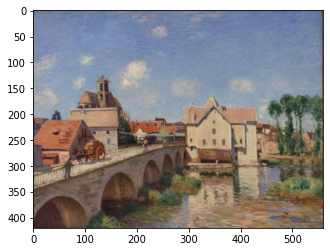

Style Image


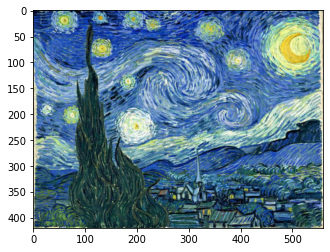

In [ ]:
content_img = load_img("./data/resized/Alfred_Sisley_96.jpg")
style_img = load_img("./data/resized/Vincent_van_Gogh_368.jpg")

print('Content Image')
plot_img(content_img)

print('Style Image')
plot_img(style_img)

### Preparing to load all images

In [ ]:
import os
from pathlib import Path
base_path = "./data/resized/"
all_images = []
for root, _, files in os.walk(Path(base_path)):
    for file in files:
        all_images.append(os.path.join(base_path, file))
len(all_images)

8355

In [ ]:
class Normalize(nn.Module):
    def __init__(self, mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]):
        super(Normalize, self).__init__()
        self.mean = torch.tensor(mean).to(device).view(-1, 1, 1)
        self.std = torch.tensor(std).to(device).view(-1, 1, 1)

    def forward(self, input):
        x = input - self.mean
        x = x / self.std
        return x

In [ ]:
model = nn.Sequential(Normalize())

In [ ]:
model(sample).shape

torch.Size([1, 3, 420, 560])

## Clustering VGG19 intermediate representations of image inputs

In [ ]:
models.vgg19(pretrained=True)

VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padd

In [ ]:
vgg19 = models.vgg19(pretrained=True).features.to(device).eval()
print(vgg19)

Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace=True)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace=True)
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace=True)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace=True)
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU(inplace=True)
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU(inplace=True)
  (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (15): ReLU(inplace=True)
  (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (17): ReLU(inplace=True)
  (18): MaxPoo

### KMeans

### KNN